<a href="https://colab.research.google.com/github/Dynamo-Dream/Stock_Price_Prediction/blob/main/NEW_ICICI_STOCK_PRice_PRediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Price Prediction of AIRTEL Stock

In [90]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.ar_model import AutoReg
import warnings
import seaborn as sns
warnings.filterwarnings("ignore")

In [91]:
df = pd.read_csv("/content/icici.csv")

In [92]:
df = df[::-1] ## Only To reverse Dataset
df = df.reset_index(drop=True)

In [93]:
df.head()

,Date,series,OPEN,HIGH,LOW,PREV. CLOSE,ltp,close,vwap,52W H,52W L,VOLUME,VALUE,No of trades
0,16-Jan-2023,EQ,877.25,877.45,861.05,873.45,865.00,865.25,868.11,958.20,642.15,"83,19,812","7,22,25,29,787.90","1,59,291"
1,17-Jan-2023,EQ,866.95,867.95,858.10,865.25,867.00,865.15,863.24,958.20,642.15,"1,26,24,859","10,89,82,50,398.60","1,96,226"
2,18-Jan-2023,EQ,864.45,872.00,858.65,865.15,870.25,869.50,866.74,958.20,642.15,"1,13,13,898","9,80,62,32,660.85","2,11,640"
3,19-Jan-2023,EQ,868.00,870.55,862.00,869.50,865.10,866.15,865.90,958.20,642.15,"66,94,679","5,79,68,99,732.40","1,47,146"
4,20-Jan-2023,EQ,873.50,876.50,865.55,866.15,871.65,870.35,870.69,958.20,642.15,"81,27,162","7,07,62,27,350.10","1,64,516"


In [94]:
df.isna().sum()

Date             0
series           0
OPEN             0
HIGH             0
LOW              0
PREV. CLOSE      0
ltp              0
close            0
vwap             0
52W H            0
52W L            0
VOLUME           0
VALUE            0
No of trades     0
dtype: int64

In [95]:
df.columns

Index(['Date ', 'series ', 'OPEN ', 'HIGH ', 'LOW ', 'PREV. CLOSE ', 'ltp ',
       'close ', 'vwap ', '52W H ', '52W L ', 'VOLUME ', 'VALUE ',
       'No of trades '],
      dtype='object')

In [96]:
target = 'close '
if(df[target].dtype == 'O'):
  df[target] = df[target].str.replace(',', '').astype(float)


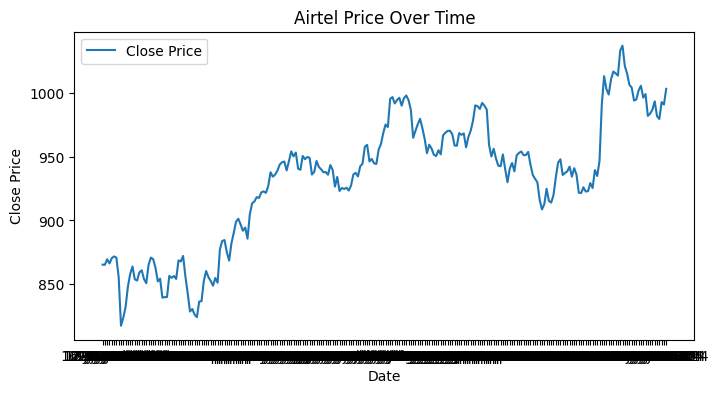

In [97]:
stock_name = "Airtel"
plt.figure(figsize=(8, 4))
plt.plot(df["Date "],df[target], label='Close Price')
plt.title( stock_name +' Price Over Time')
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.legend()
plt.show()

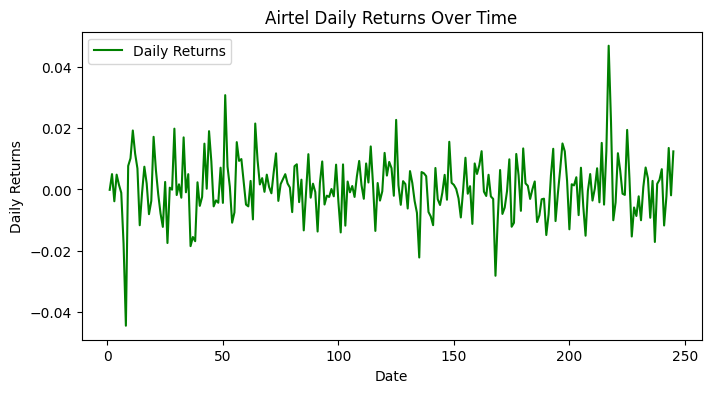

In [98]:
daily_returns = df[target].pct_change()
plt.figure(figsize=(8, 4))
plt.plot(daily_returns, label='Daily Returns', color='green')
plt.title(stock_name+ ' Daily Returns Over Time')
plt.xlabel('Date')
plt.ylabel('Daily Returns')
plt.legend()
plt.show()

In [99]:
print("Summary Statistics:")
print(df[target].describe())

Summary Statistics:
count     246.000000
mean      931.799187
std        50.431183
min       817.200000
25%       897.387500
50%       940.025000
75%       966.550000
max      1037.400000
Name: close , dtype: float64


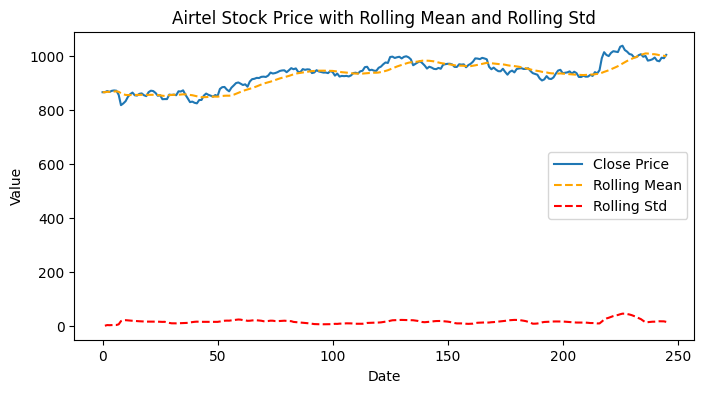

In [100]:
window = 20
df['Rolling Mean'] = df[target].rolling(window=window,min_periods=1).mean()
df['Rolling Std'] = df[target].rolling(window=window,min_periods=1).std()

plt.figure(figsize=(8, 4))
plt.plot(df[target], label='Close Price')
plt.plot(df['Rolling Mean'],  linestyle='--', color='orange',label="Rolling Mean")
plt.plot(df['Rolling Std'], linestyle='--', color='red',label = "Rolling Std")
plt.title(stock_name + ' Stock Price with Rolling Mean and Rolling Std')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()

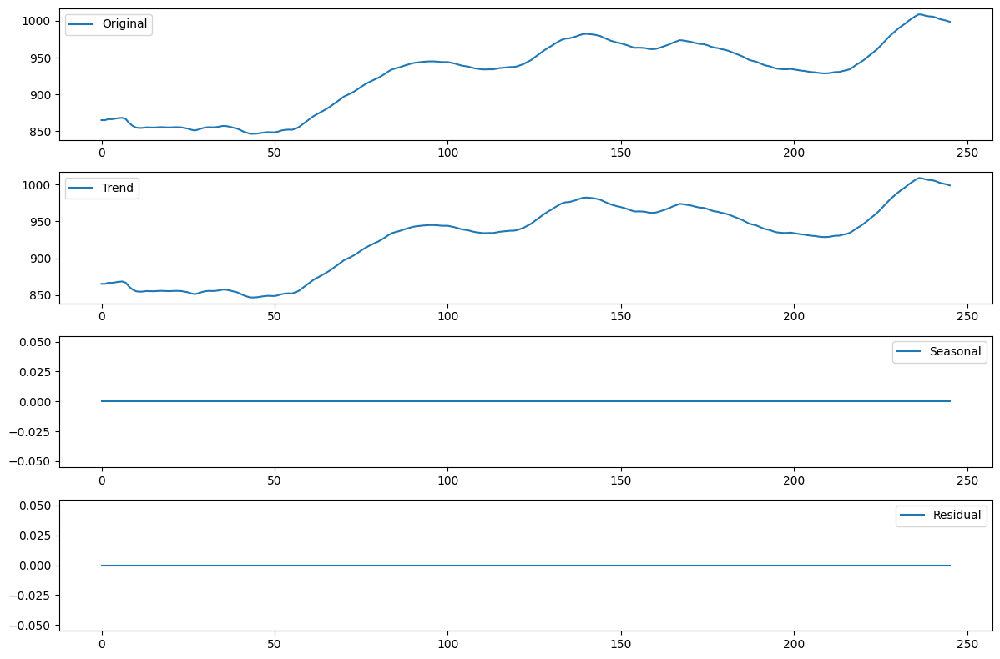

In [101]:
from statsmodels.tsa.seasonal import seasonal_decompose
result = seasonal_decompose(df["Rolling Mean"], model='additive', period=1)
plt.figure(figsize=(12, 8))

plt.subplot(4, 1, 1)
plt.plot(df.index,df["Rolling Mean"], label='Original')
plt.legend()

plt.subplot(4, 1, 2)
plt.plot(result.trend, label='Trend')
plt.legend()

plt.subplot(4, 1, 3)
plt.plot(result.seasonal, label='Seasonal')
plt.legend()

plt.subplot(4, 1, 4)
plt.plot(result.resid, label='Residual')
plt.legend()

plt.tight_layout()
plt.show()

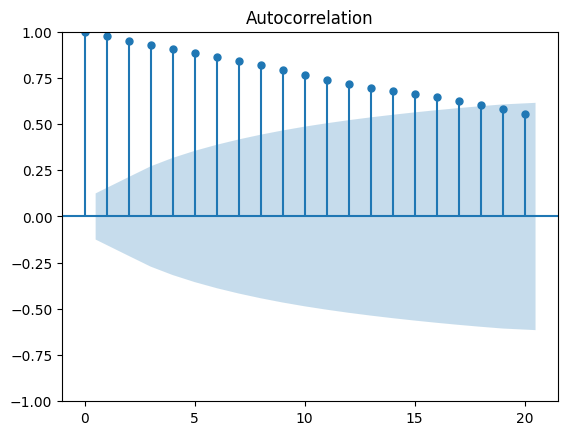

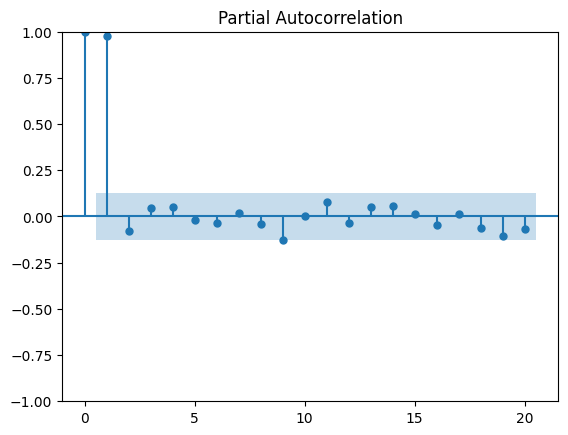

In [102]:
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf
lag = 20
acf = plot_acf(df[target],lags = lag)
pacf = plot_pacf(df[target],lags = lag)

In [103]:
from statsmodels.tsa.stattools import adfuller
dftest = adfuller(df[target],autolag='AIC')
print("ADF: ", dftest[0])
print("P-Value: ", dftest[1])
print("Num Of Lags: ", dftest[2])
print("Num of observation used for ADF Regression and Critical Values Calculation: ", dftest[3])
print("Critical Value")
for key,val in dftest[4].items():
    print("\t",key,": ",val)

ADF:  -1.5538241815597715
P-Value:  0.5067374139005026
Num Of Lags:  1
Num of observation used for ADF Regression and Critical Values Calculation:  244
Critical Value
	 1% :  -3.457437824930831
	 5% :  -2.873459364726563
	 10% :  -2.573122099570008


In [104]:
df.set_index("Date ", inplace=True)
data = df[target]

In [105]:
data = pd.DataFrame(data,columns=['close '])
data.head()

,close
Date,
16-Jan-2023,865.25
17-Jan-2023,865.15
18-Jan-2023,869.50
19-Jan-2023,866.15
20-Jan-2023,870.35


In [106]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

In [107]:
length = data.size
timestamp = 20
percent_data = 0.85

In [108]:
data

,close
Date,
16-Jan-2023,865.25
17-Jan-2023,865.15
18-Jan-2023,869.50
19-Jan-2023,866.15
20-Jan-2023,870.35
...,...
08-Jan-2024,982.00
09-Jan-2024,979.75
10-Jan-2024,993.05


In [109]:
from math import ceil
train = data.iloc[:ceil(length*percent_data),0]
test = data.iloc[ceil(length*percent_data)-timestamp:,0]

In [110]:
train = pd.DataFrame(train,columns=['close '])
test = pd.DataFrame(test,columns=['close '])

In [111]:
train.head()

,close
Date,
16-Jan-2023,865.25
17-Jan-2023,865.15
18-Jan-2023,869.50
19-Jan-2023,866.15
20-Jan-2023,870.35


In [112]:
scaler.fit(train)

MinMaxScaler()

In [113]:
scaled_train = scaler.transform(train)
scaled_test = scaler.transform(test)

In [114]:
scaled_train

array([[0.26532303],
       [0.26477084],
       [0.28879072],
       [0.27029266],
       [0.29348426],
       [0.30093871],
       [0.29569299],
       [0.210381  ],
       [0.        ],
       [0.03478741],
       [0.08117062],
       [0.16979569],
       [0.22473771],
       [0.2573164 ],
       [0.20154611],
       [0.19630039],
       [0.23136389],
       [0.24075097],
       [0.20237438],
       [0.18470458],
       [0.26559912],
       [0.29596908],
       [0.28851463],
       [0.25096632],
       [0.19271121],
       [0.20430701],
       [0.12175594],
       [0.12451684],
       [0.12424075],
       [0.216455  ],
       [0.20789619],
       [0.21590282],
       [0.20320265],
       [0.283545  ],
       [0.27912755],
       [0.30314743],
       [0.21397018],
       [0.14053009],
       [0.06184428],
       [0.07261182],
       [0.04803976],
       [0.03699613],
       [0.1051905 ],
       [0.10629486],
       [0.19436775],
       [0.23743788],
       [0.21120928],
       [0.194

In [115]:
train_length = scaled_train.size
val_percent = 0.10
train_data = scaled_train[:ceil(train_length*(1-val_percent))]
val_data = scaled_train[ceil(train_length*(1-val_percent))-timestamp:]
train_length

210

In [116]:
def GenerateTimeSeries(dataset, timestamp, dataset_length):
  X = []
  Y = []
  for i in range(timestamp, dataset_length):
    X.append(dataset[i-timestamp:i,0])
    Y.append(dataset[i,0])
  X,Y = np.array(X),np.array(Y)

  return X,Y


In [117]:
train_data.shape[0]

189

In [118]:
timestamp = 20
X_train,Y_train = GenerateTimeSeries(train_data,timestamp, train_data.shape[0])

X_test,Y_test = GenerateTimeSeries(scaled_test, timestamp, scaled_test.shape[0])

In [119]:
X_val, Y_val = GenerateTimeSeries(val_data, timestamp, val_data.shape[0])

In [120]:
X_train,Y_train

(array([[0.26532303, 0.26477084, 0.28879072, ..., 0.24075097, 0.20237438,
         0.18470458],
        [0.26477084, 0.28879072, 0.27029266, ..., 0.20237438, 0.18470458,
         0.26559912],
        [0.28879072, 0.27029266, 0.29348426, ..., 0.18470458, 0.26559912,
         0.29596908],
        ...,
        [0.95527333, 0.93843181, 0.78464936, ..., 0.74047488, 0.74102706,
         0.75483158],
        [0.93843181, 0.78464936, 0.73495306, ..., 0.74102706, 0.75483158,
         0.6987852 ],
        [0.78464936, 0.73495306, 0.76836002, ..., 0.75483158, 0.6987852 ,
         0.65461071]]),
 array([0.26559912, 0.29596908, 0.28851463, 0.25096632, 0.19271121,
        0.20430701, 0.12175594, 0.12451684, 0.12424075, 0.216455  ,
        0.20789619, 0.21590282, 0.20320265, 0.283545  , 0.27912755,
        0.30314743, 0.21397018, 0.14053009, 0.06184428, 0.07261182,
        0.04803976, 0.03699613, 0.1051905 , 0.10629486, 0.19436775,
        0.23743788, 0.21120928, 0.19436775, 0.17393705, 0.20734401,
 

In [121]:
from keras.models import Sequential,Model
from keras.layers import Dense,LSTM,Dropout,GRU, Input

In [122]:
def lstm_model(input_shape):
  regressor = Sequential()
  regressor.add(LSTM(units=100,return_sequences=True, input_shape = input_shape))
  regressor.add(Dropout(0.2))
  regressor.add(LSTM(units=100, return_sequences=True))
  regressor.add(Dropout(0.2))
  regressor.add(LSTM(units=100, return_sequences=True))
  regressor.add(Dropout(0.2))
  regressor.add(LSTM(units=100, return_sequences=True))
  regressor.add(Dropout(0.2))
  regressor.add(LSTM(units=100))
  regressor.add(Dropout(0.2))
  regressor.add(Dense(units=1))

  noise = Input(shape = input_shape)
  output = regressor(noise)

  regressor.summary()
  return Model(noise,output)

def gru_model(input_shape):
  regressor = Sequential()
  regressor.add(GRU(units=100, return_sequences=True, input_shape = input_shape))
  regressor.add(Dropout(0.2))
  regressor.add(GRU(units=100, return_sequences=True))
  regressor.add(Dropout(0.2))
  regressor.add(GRU(units=100, return_sequences=True))
  regressor.add(Dropout(0.2))
  regressor.add(GRU(units=100, return_sequences=True))
  regressor.add(Dropout(0.2))
  regressor.add(GRU(units=100))
  regressor.add(Dropout(0.2))
  regressor.add(Dense(units=1))

  noise = Input(shape = input_shape)
  output = regressor(noise)
  regressor.summary()
  return Model(noise,output)

In [123]:
feature = 1
input_shape = (timestamp,feature)
lstm = lstm_model(input_shape)
gru = gru_model(input_shape)

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_5 (LSTM)               (None, 20, 100)           40800     
                                                                 
 dropout_10 (Dropout)        (None, 20, 100)           0         
                                                                 
 lstm_6 (LSTM)               (None, 20, 100)           80400     
                                                                 
 dropout_11 (Dropout)        (None, 20, 100)           0         
                                                                 
 lstm_7 (LSTM)               (None, 20, 100)           80400     
                                                                 
 dropout_12 (Dropout)        (None, 20, 100)           0         
                                                                 
 lstm_8 (LSTM)               (None, 20, 100)          

In [124]:
lstm.compile(optimizer='adam', loss='mse')
gru.compile(optimizer='adam', loss='mse')

In [125]:
from tensorflow.keras.callbacks import EarlyStopping
early_stopping_callback = EarlyStopping(
    monitor='val_loss',
    patience=6,
    verbose=1,
    mode='min'
)

In [126]:
lstm.fit(X_train, Y_train, validation_data= (X_val,Y_val), epochs=150, batch_size=32)

Epoch 1/150
6/6 [==============================] - 14s 493ms/step - loss: 0.2465 - val_loss: 0.1293
Epoch 2/150
6/6 [==============================] - 0s 82ms/step - loss: 0.0646 - val_loss: 0.0459
Epoch 3/150
6/6 [==============================] - 1s 87ms/step - loss: 0.0536 - val_loss: 0.0377
Epoch 4/150
6/6 [==============================] - 0s 83ms/step - loss: 0.0389 - val_loss: 0.0060
Epoch 5/150
6/6 [==============================] - 1s 85ms/step - loss: 0.0299 - val_loss: 0.0061
Epoch 6/150
6/6 [==============================] - 0s 80ms/step - loss: 0.0254 - val_loss: 0.0180
Epoch 7/150
6/6 [==============================] - 0s 84ms/step - loss: 0.0223 - val_loss: 0.0073
Epoch 8/150
6/6 [==============================] - 0s 81ms/step - loss: 0.0208 - val_loss: 0.0187
Epoch 9/150
6/6 [==============================] - 1s 86ms/step - loss: 0.0196 - val_loss: 0.0096
Epoch 10/150
6/6 [==============================] - 0s 84ms/step - loss: 0.0186 - val_loss: 0.0189
Epoch 11/150
6/6 

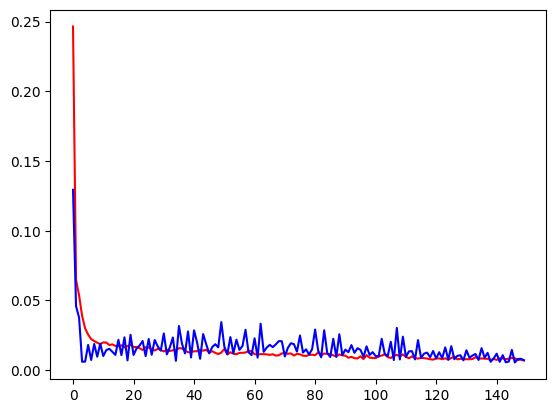

In [127]:
plt.plot(lstm.history.history['loss'],color='red',label='train')
plt.plot(lstm.history.history['val_loss'],color='blue',label='train')

In [128]:
gru.fit(X_train, Y_train, validation_data= (X_val,Y_val), epochs=150, batch_size=32)

Epoch 1/150
6/6 [==============================] - 13s 444ms/step - loss: 0.1716 - val_loss: 0.0122
Epoch 2/150
6/6 [==============================] - 0s 77ms/step - loss: 0.0514 - val_loss: 0.0074
Epoch 3/150
6/6 [==============================] - 0s 75ms/step - loss: 0.0273 - val_loss: 0.0194
Epoch 4/150
6/6 [==============================] - 0s 79ms/step - loss: 0.0230 - val_loss: 0.0076
Epoch 5/150
6/6 [==============================] - 0s 78ms/step - loss: 0.0179 - val_loss: 0.0183
Epoch 6/150
6/6 [==============================] - 0s 75ms/step - loss: 0.0154 - val_loss: 0.0073
Epoch 7/150
6/6 [==============================] - 0s 77ms/step - loss: 0.0166 - val_loss: 0.0117
Epoch 8/150
6/6 [==============================] - 0s 78ms/step - loss: 0.0131 - val_loss: 0.0080
Epoch 9/150
6/6 [==============================] - 0s 77ms/step - loss: 0.0153 - val_loss: 0.0098
Epoch 10/150
6/6 [==============================] - 0s 79ms/step - loss: 0.0152 - val_loss: 0.0078
Epoch 11/150
6/6 

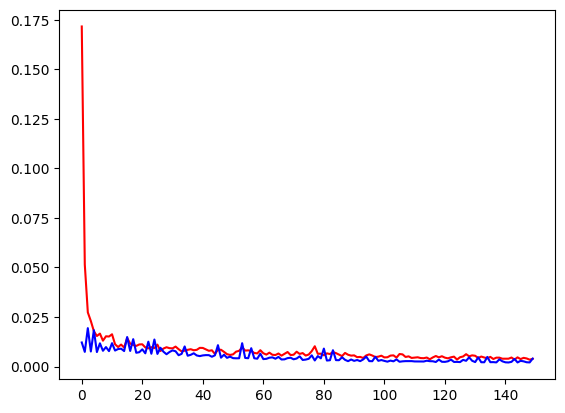

In [129]:
plt.plot(gru.history.history['loss'],color='red',label='train')
plt.plot(gru.history.history['val_loss'],color='blue',label='train')

In [130]:
gru_pred = gru.predict(X_test)

2/2 [==============================] - 2s 17ms/step


In [131]:
lstm_pred = lstm.predict(X_test)

2/2 [==============================] - 3s 13ms/step


In [132]:
gru_pred[0],lstm_pred[0],Y_test[0]

(array([0.64532024], dtype=float32),
 array([0.6448341], dtype=float32),
 0.582827167310878)

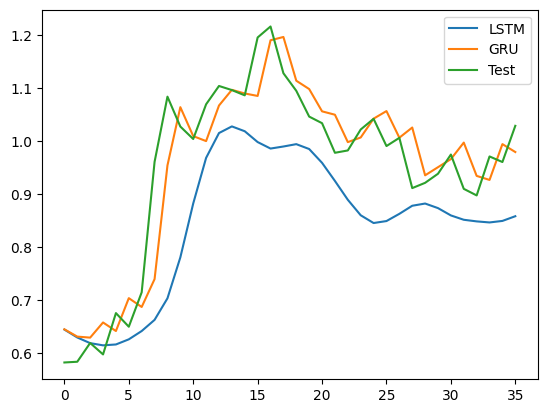

In [133]:
plt.plot(lstm_pred, label='LSTM')
plt.plot(gru_pred, label='GRU')
plt.plot(Y_test,label="Test")
plt.legend()
plt.show()

In [134]:
lstm_pred = np.array(lstm_pred)
gru_pred = np.array(gru_pred)

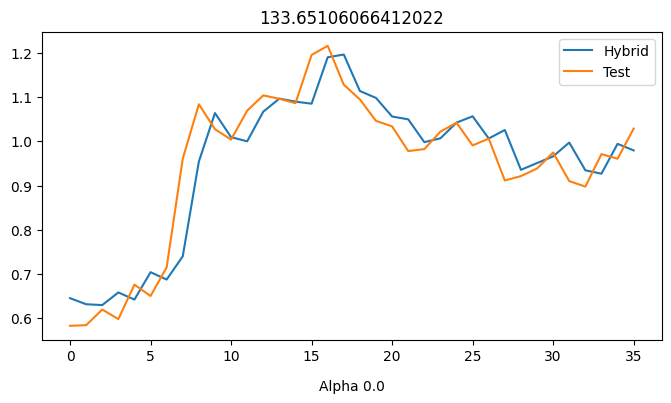

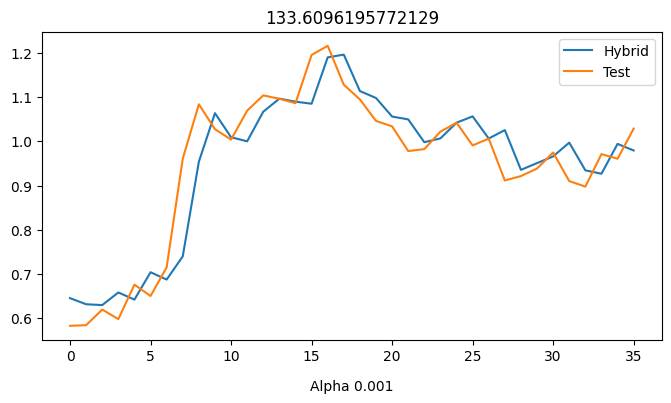

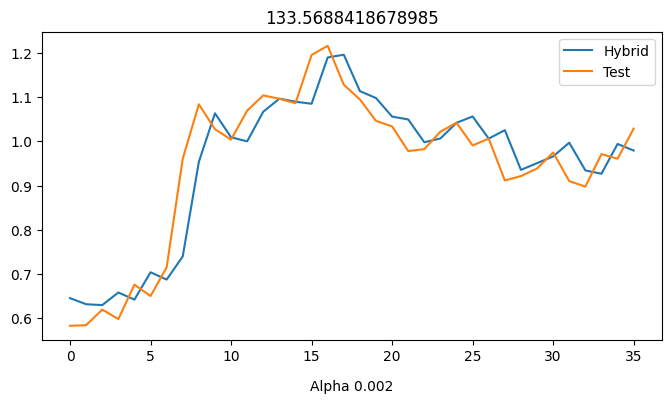

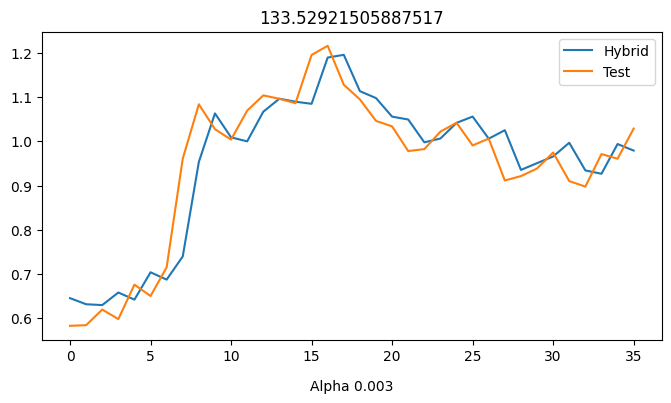

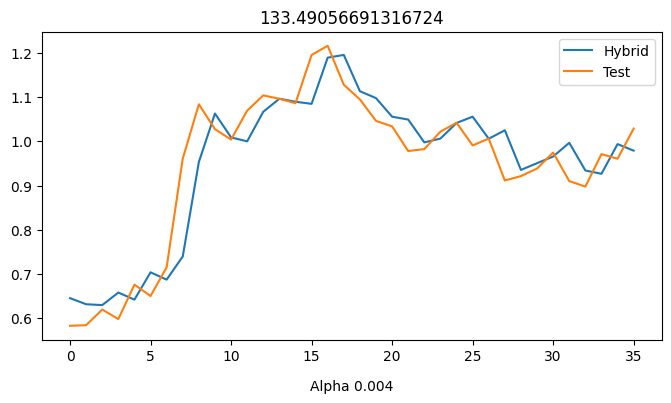

...

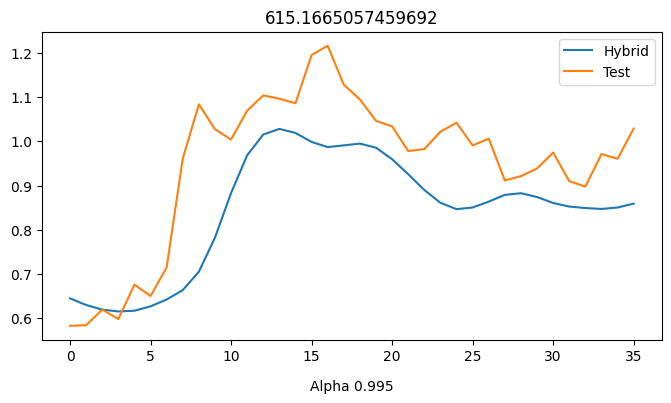

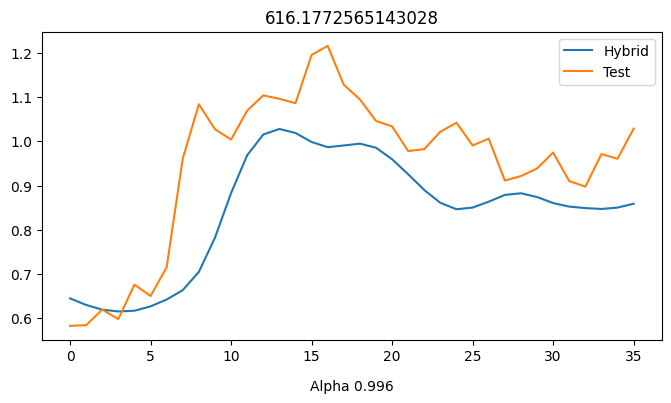

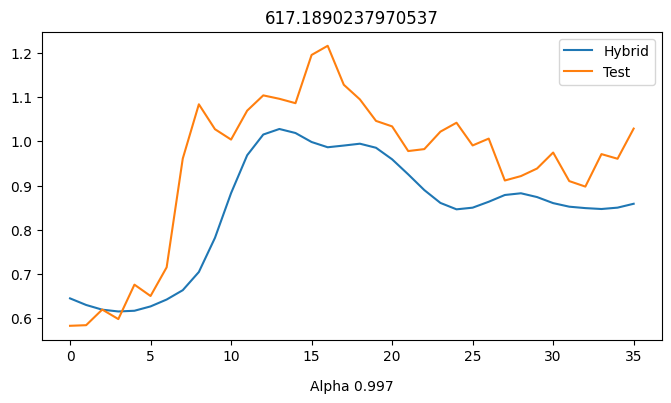

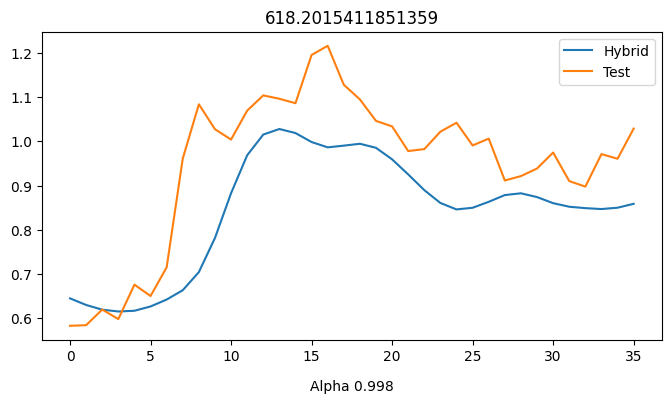

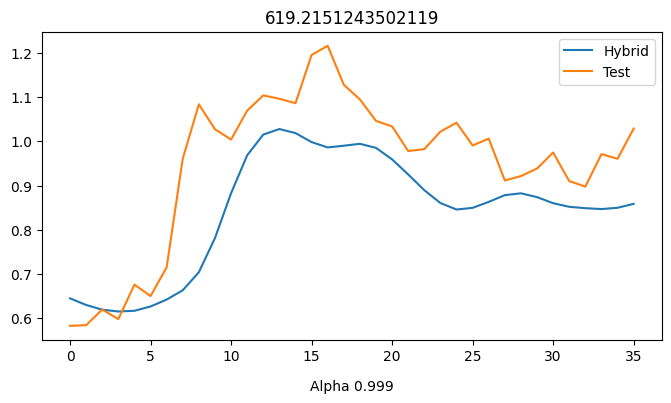

In [135]:
from sklearn.metrics import mean_squared_error
temp = 99999999
alpha = 0
inverse_Y_test = scaler.inverse_transform(Y_test.reshape(-1,1))
for i in range(0,1000):
  fig, ax = plt.subplots(figsize=(8, 4))

  a = i / 1000
  hybrid_pred_temp = a * lstm_pred + (1 - a) * gru_pred

  plt.plot(hybrid_pred_temp, label="Hybrid")
  plt.plot(Y_test, label="Test")
  plt.text(0.5, -0.15, f'Alpha {a}', ha='center', va='center', transform=ax.transAxes)

  inverse_Y_pred = scaler.inverse_transform(hybrid_pred_temp)
  mse_temp  = mean_squared_error(inverse_Y_test, inverse_Y_pred)
  if(mse_temp<temp):
    temp = mse_temp
    alpha = a
  plt.title(mse_temp)
  plt.legend()

  plt.show()


In [136]:
alpha

0.04

In [137]:
hybrid_pred = alpha * lstm_pred + (1 - alpha) * gru_pred

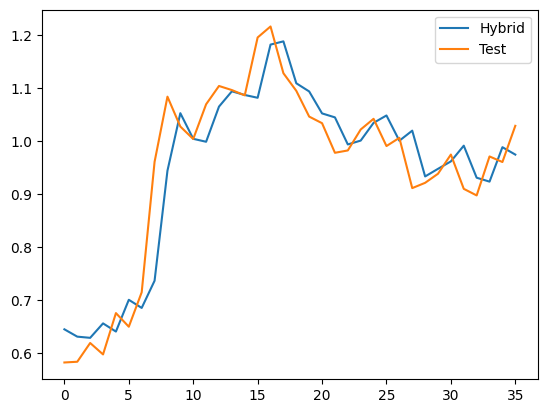

In [138]:
plt.plot(hybrid_pred,label="Hybrid")
plt.plot(Y_test,label="Test")
plt.legend()
plt.show()

In [139]:
lstm_pred

array([[0.6448341 ],
       [0.6299252 ],
       [0.61924845],
       [0.61510605],
       [0.61676717],
       [0.6264363 ],
       [0.6420807 ],
       [0.6631102 ],
       [0.70373   ],
       [0.78085804],
       [0.88240653],
       [0.9683485 ],
       [1.0151192 ],
       [1.02762   ],
       [1.0185012 ],
       [0.99812055],
       [0.9858906 ],
       [0.9897507 ],
       [0.99419194],
       [0.9850126 ],
       [0.95897925],
       [0.9248512 ],
       [0.8893535 ],
       [0.8601993 ],
       [0.8455686 ],
       [0.84929526],
       [0.8628805 ],
       [0.8781307 ],
       [0.8822958 ],
       [0.8736676 ],
       [0.8598954 ],
       [0.85171187],
       [0.84866834],
       [0.84666   ],
       [0.84953636],
       [0.8583988 ]], dtype=float32)

In [140]:
hybrid_pred_real = scaler.inverse_transform(hybrid_pred)
y_real = scaler.inverse_transform(Y_test.reshape(-1,1))
hybrid_pred_real,y_real

(array([[ 934.06396],
        [ 931.5649 ],
        [ 931.1582 ],
        [ 936.0898 ],
        [ 933.29694],
        [ 944.1399 ],
        [ 941.36096],
        [ 950.6397 ],
        [ 988.1852 ],
        [1007.8164 ],
        [ 999.0669 ],
        [ 998.0629 ],
        [1010.0572 ],
        [1015.2787 ],
        [1014.0252 ],
        [1013.0688 ],
        [1031.2198 ],
        [1032.3208 ],
        [1018.0262 ],
        [1015.23193],
        [1007.7395 ],
        [1006.3838 ],
        [ 997.15155],
        [ 998.4625 ],
        [1004.5216 ],
        [1007.03064],
        [ 998.41113],
        [1001.8529 ],
        [ 986.2282 ],
        [ 988.82623],
        [ 991.3694 ],
        [ 996.7277 ],
        [ 985.79584],
        [ 984.4596 ],
        [ 996.2108 ],
        [ 993.68463]], dtype=float32),
 array([[ 922.75],
        [ 923.  ],
        [ 929.4 ],
        [ 925.5 ],
        [ 939.6 ],
        [ 934.95],
        [ 946.7 ],
        [ 991.2 ],
        [1013.45],
        [1003.25],
 

In [141]:
from sklearn.metrics import mean_absolute_error
mae = mean_absolute_error(y_real, hybrid_pred_real)
mae

8.243673706054715

In [142]:
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_real, hybrid_pred_real)
rmse = np.sqrt(mse)

print(f"MAE: {mae}")
print(f"MSE: {mse}")
print(f"RMSE: {rmse}")

MAE: 8.243673706054715
MSE: 132.80560898942707
RMSE: 11.524131593722238


In [143]:
lstm_pred = scaler.inverse_transform(lstm_pred)
mae1 = mean_absolute_error(y_real, lstm_pred)
mse1 = mean_squared_error(y_real, lstm_pred)
rmse1 = np.sqrt(mse1)
print(f"MAE: {mae1}")
print(f"MSE: {mse1}")
print(f"RMSE: {rmse1}")

MAE: 20.15667215983074
MSE: 620.2303356893412
RMSE: 24.904424018421732


In [144]:
gru_pred = scaler.inverse_transform(gru_pred)
mae1 = mean_absolute_error(y_real, gru_pred)
mse1 = mean_squared_error(y_real, gru_pred)
rmse1 = np.sqrt(mse1)
print(f"MAE: {mae1}")
print(f"MSE: {mse1}")
print(f"RMSE: {rmse1}")

MAE: 8.375974188910611
MSE: 133.65106066412022
RMSE: 11.560755194368586


In [145]:
lstm_pred_train = lstm.predict(X_train)
gru_pred_train = gru.predict(X_train)


6/6 [==============================] - 0s 27ms/step


In [146]:
lstm_pred_val = lstm.predict(X_val)
gru_pred_val = gru.predict(X_val)

1/1 [==============================] - 0s 48ms/step


In [147]:
hybrid_prediction_train = alpha * lstm_pred_train + (1 - alpha) * gru_pred_train
hybrid_prediction_train = scaler.inverse_transform(hybrid_prediction_train)

In [148]:
hybrid_prediction_val = alpha * lstm_pred_val + (1 - alpha) * gru_pred_val
hybrid_prediction_val = scaler.inverse_transform(hybrid_prediction_val)

In [149]:
hybrid_prediction_val

array([[941.60834],
       [939.11835],
       [927.5124 ],
       [920.19086],
       [922.4901 ],
       [932.0828 ],
       [925.04156],
       [922.54486],
       [926.91583],
       [938.36163],
       [948.7594 ],
       [951.6365 ],
       [941.868  ],
       [943.01825],
       [944.7645 ],
       [948.1701 ],
       [941.9887 ],
       [947.0238 ],
       [943.35016],
       [931.4996 ],
       [930.23816]], dtype=float32)

In [150]:
y_plot = df[target]
y_plot = y_plot[timestamp:]


In [151]:
indexes = y_plot.index

In [152]:
indexes

Index(['14-Feb-2023', '15-Feb-2023', '16-Feb-2023', '17-Feb-2023',
       '20-Feb-2023', '21-Feb-2023', '22-Feb-2023', '23-Feb-2023',
       '24-Feb-2023', '27-Feb-2023',
       ...
       '01-Jan-2024', '02-Jan-2024', '03-Jan-2024', '04-Jan-2024',
       '05-Jan-2024', '08-Jan-2024', '09-Jan-2024', '10-Jan-2024',
       '11-Jan-2024', '12-Jan-2024'],
      dtype='object', name='Date ', length=226)

In [153]:
hybrid_pred_test = hybrid_pred_real.flatten()

In [154]:
hybrid_prediction_train = hybrid_prediction_train.flatten()
hybrid_prediction_val = hybrid_prediction_val.flatten()

In [155]:
value = np.concatenate((hybrid_prediction_train,hybrid_prediction_val))
value = np.concatenate((value,hybrid_pred_test))

In [156]:
value_df = pd.DataFrame(value,index = indexes,columns=["Close"])


In [157]:
y_df = pd.DataFrame(y_plot)
y_df

,close
Date,
14-Feb-2023,865.30
15-Feb-2023,870.80
16-Feb-2023,869.45
17-Feb-2023,862.65
20-Feb-2023,852.10
...,...
08-Jan-2024,982.00
09-Jan-2024,979.75
10-Jan-2024,993.05


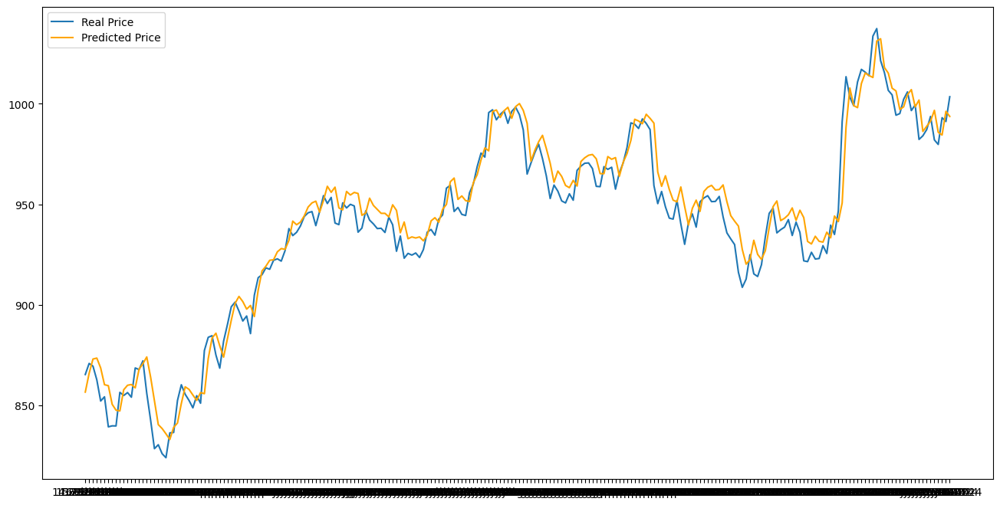

In [158]:
plt.figure(figsize=(16, 8))
plt.plot(y_df.index,y_df['close '],label='Real Price')
plt.plot(value_df, label='Predicted Price',color='orange')
plt.legend()
plt.show()

In [159]:
new_df = df.reset_index()
new_df = new_df[["Date ","close "]]
new_df = new_df.rename(columns = {"Date ":"ds","close ":"y"})
new_df.head()

,ds,y
0,16-Jan-2023,865.25
1,17-Jan-2023,865.15
2,18-Jan-2023,869.50
3,19-Jan-2023,866.15
4,20-Jan-2023,870.35


In [160]:
import datetime
new_df['ds'] = new_df['ds'].apply(lambda x: datetime.datetime.strptime(x, '%d-%b-%Y').strftime('%Y-%m-%d'))

In [161]:
from prophet import Prophet
fbp = Prophet(daily_seasonality = True)
fbp.fit(new_df)
fut = fbp.make_future_dataframe(periods=2)
forecast = fbp.predict(fut)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuvehkepm/9qw1xx8d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuvehkepm/7a6596lh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83367', 'data', 'file=/tmp/tmpuvehkepm/9qw1xx8d.json', 'init=/tmp/tmpuvehkepm/7a6596lh.json', 'output', 'file=/tmp/tmpuvehkepm/prophet_modelkj3ke8k0/prophet_model-20240114162854.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:28:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:28:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [162]:
from prophet.plot import plot_plotly, plot_components_plotly
plot_plotly(fbp, forecast)

In [163]:
prophet_model2 = Prophet()

In [164]:
train = train.reset_index()

In [165]:
train = train[["Date ","close "]]
train = train.rename(columns = {"Date ":"ds","close ":"y"})

In [166]:
train.head()

,ds,y
0,16-Jan-2023,865.25
1,17-Jan-2023,865.15
2,18-Jan-2023,869.50
3,19-Jan-2023,866.15
4,20-Jan-2023,870.35


In [167]:
train['ds'] = train['ds'].apply(lambda x: datetime.datetime.strptime(x, '%d-%b-%Y').strftime('%Y-%m-%d'))

In [168]:
new_test = test[20:]

In [169]:
prophet_model2.fit(train)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuvehkepm/u22zczce.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuvehkepm/vrgy8fxc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95148', 'data', 'file=/tmp/tmpuvehkepm/u22zczce.json', 'init=/tmp/tmpuvehkepm/vrgy8fxc.json', 'output', 'file=/tmp/tmpuvehkepm/prophet_modelz36tczl2/prophet_model-20240114162855.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:28:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:28:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [170]:
future = prophet_model2.make_future_dataframe(periods=len(new_test))
prophet_predictions = prophet_model2.predict(future)

In [171]:
prophet_predictions.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2023-01-16,862.495261,844.127519,876.936313,862.495261,862.495261,-2.412399,-2.412399,-2.412399,-2.412399,-2.412399,-2.412399,0.0,0.0,0.0,860.082862
1,2023-01-17,862.268645,844.083263,876.410911,862.268645,862.268645,-1.436690,-1.436690,-1.436690,-1.436690,-1.436690,-1.436690,0.0,0.0,0.0,860.831956
2,2023-01-18,862.042029,845.264255,876.381398,862.042029,862.042029,-2.382937,-2.382937,-2.382937,-2.382937,-2.382937,-2.382937,0.0,0.0,0.0,859.659092
3,2023-01-19,861.815413,842.720450,874.671488,861.815413,861.815413,-3.414559,-3.414559,-3.414559,-3.414559,-3.414559,-3.414559,0.0,0.0,0.0,858.400854
4,2023-01-20,861.588797,842.602818,873.643844,861.588797,861.588797,-3.443374,-3.443374,-3.443374,-3.443374,-3.443374,-3.443374,0.0,0.0,0.0,858.145423


In [172]:
test_real = df.iloc[:,6:7]
test_pred = prophet_predictions['yhat']

In [173]:
test_real = test_real['close ']

In [174]:
mse_prophet = mean_squared_error(test_real,test_pred)
mse_prophet

1143.3939629258086

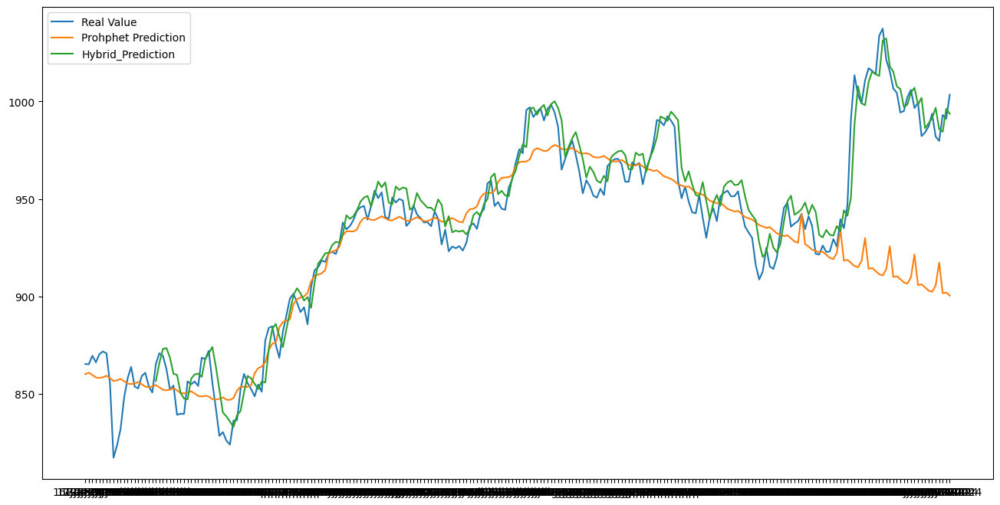

In [175]:
plt.figure(figsize=(16, 8))
plt.plot(test_real, label = "Real Value")
plt.plot(test_pred, label="Prohphet Prediction")
plt.plot(value_df['Close'], label = "Hybrid_Prediction")
plt.legend()
plt.show()

In [176]:
import joblib

In [177]:
joblib.dump(lstm_model, 'lstm_model.joblib')
joblib.dump(gru_model, 'gru_model.joblib')

['gru_model.joblib']

In [178]:
joblib.dump(prophet_model2, 'prophet_model.joblib')

['prophet_model.joblib']